# Customer Churn Dataset

In [1]:
# Installing Required Modules
%pip install pandas-profiling==3.4.0
%pip install lazypredict
%pip install keras-tuner -q

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from pandas_profiling import ProfileReport
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from lazypredict.Supervised import LazyClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier

from tensorflow import keras
from tensorflow.keras import layers
import keras_tuner as kt
from keras.layers import Dense, BatchNormalization, Dropout
from keras.models import Sequential
from keras.callbacks import EarlyStopping

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report, roc_curve
from sklearn import metrics

# A) Dataset Information

In [3]:
# Reading All Datasets
df1 = pd.read_csv('Telco_customer_churn.csv')
df2 = pd.read_csv('Telco_customer_churn_demographics.csv')
df3 = pd.read_csv('Telco_customer_churn_location.csv')
df4 = pd.read_csv('Telco_customer_churn_population.csv')
df5 = pd.read_csv('Telco_customer_churn_services.csv')
df6 = pd.read_csv('Telco_customer_churn_status.csv')

In [4]:
# Matching Column Name with the other datasets
df1['Customer ID'] = df1['CustomerID']
df1.drop('CustomerID',axis=1,inplace=True)
df1.head()

,Count,Country,State,City,Zip Code,Lat Long,Latitude,Longitude,Gender,Senior Citizen,...,Paperless Billing,Payment Method,Monthly Charges,Total Charges,Churn Label,Churn Value,Churn Score,CLTV,Churn Reason,Customer ID
0,1,United States,California,Los Angeles,90003,"33.964131, -118.272783",33.96,-118.27,Male,No,...,Yes,Mailed check,53.85,108.15,Yes,1,86,3239,Competitor made better offer,3668-QPYBK
1,1,United States,California,Los Angeles,90005,"34.059281, -118.30742",34.06,-118.31,Female,No,...,Yes,Electronic check,70.70,151.65,Yes,1,67,2701,Moved,9237-HQITU
2,1,United States,California,Los Angeles,90006,"34.048013, -118.293953",34.05,-118.29,Female,No,...,Yes,Electronic check,99.65,820.5,Yes,1,86,5372,Moved,9305-CDSKC
3,1,United States,California,Los Angeles,90010,"34.062125, -118.315709",34.06,-118.32,Female,No,...,Yes,Electronic check,104.80,3046.05,Yes,1,84,5003,Moved,7892-POOKP
4,1,United States,California,Los Angeles,90015,"34.039224, -118.266293",34.04,-118.27,Male,No,...,Yes,Bank transfer (automatic),103.70,5036.3,Yes,1,89,5340,Competitor had better devices,0280-XJGEX


In [5]:
# Sorting according to Customer ID
df1.set_index('Customer ID',inplace=True)
df1.sort_values('Customer ID',inplace=True)
df1.head()

,Count,Country,State,City,Zip Code,Lat Long,Latitude,Longitude,Gender,Senior Citizen,...,Contract,Paperless Billing,Payment Method,Monthly Charges,Total Charges,Churn Label,Churn Value,Churn Score,CLTV,Churn Reason
Customer ID,,,,,,,,,,,,,,,,,,,,,
0002-ORFBO,1,United States,California,Frazier Park,93225,"34.827662, -118.999073",34.83,-119.00,Female,No,...,One year,Yes,Mailed check,65.60,593.3,No,0,65,2205,NaN
0003-MKNFE,1,United States,California,Glendale,91206,"34.162515, -118.203869",34.16,-118.20,Male,No,...,Month-to-month,No,Mailed check,59.90,542.4,No,0,66,5414,NaN
0004-TLHLJ,1,United States,California,Costa Mesa,92627,"33.645672, -117.922613",33.65,-117.92,Male,No,...,Month-to-month,Yes,Electronic check,73.90,280.85,Yes,1,71,4479,Price too high
0011-IGKFF,1,United States,California,Martinez,94553,"38.014457, -122.115432",38.01,-122.12,Male,Yes,...,Month-to-month,Yes,Electronic check,98.00,1237.85,Yes,1,99,3714,Product dissatisfaction
0013-EXCHZ,1,United States,California,Camarillo,93010,"34.227846, -119.079903",34.23,-119.08,Female,Yes,...,Month-to-month,Yes,Mailed check,83.90,267.4,Yes,1,68,3464,Network reliability


In [6]:
# Dataset Info
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7043 entries, 0002-ORFBO to 9995-HOTOH
Data columns (total 32 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Count              7043 non-null   int64  
 1   Country            7043 non-null   object 
 2   State              7043 non-null   object 
 3   City               7043 non-null   object 
 4   Zip Code           7043 non-null   int64  
 5   Lat Long           7043 non-null   object 
 6   Latitude           7043 non-null   float64
 7   Longitude          7043 non-null   float64
 8   Gender             7043 non-null   object 
 9   Senior Citizen     7043 non-null   object 
 10  Partner            7043 non-null   object 
 11  Dependents         7043 non-null   object 
 12  Tenure Months      7043 non-null   int64  
 13  Phone Service      7043 non-null   object 
 14  Multiple Lines     7043 non-null   object 
 15  Internet Service   7043 non-null   object 
 16  Online Securit

In [7]:
# Checking for Nan 
df1.isna().sum()

Count                   0
Country                 0
State                   0
City                    0
Zip Code                0
Lat Long                0
Latitude                0
Longitude               0
Gender                  0
Senior Citizen          0
Partner                 0
Dependents              0
Tenure Months           0
Phone Service           0
Multiple Lines          0
Internet Service        0
Online Security         0
Online Backup           0
Device Protection       0
Tech Support            0
Streaming TV            0
Streaming Movies        0
Contract                0
Paperless Billing       0
Payment Method          0
Monthly Charges         0
Total Charges           0
Churn Label             0
Churn Value             0
Churn Score             0
CLTV                    0
Churn Reason         5174
dtype: int64

In [8]:
# Setting Dataset Index
df2.set_index('Customer ID',inplace=True)
df2.sort_values('Customer ID',inplace=True)
df2.head()

,Count,Gender,Age,Under 30,Senior Citizen,Married,Dependents,Number of Dependents
Customer ID,,,,,,,,
0002-ORFBO,1,Female,37,No,No,Yes,No,0
0003-MKNFE,1,Male,46,No,No,No,No,0
0004-TLHLJ,1,Male,50,No,No,No,No,0
0011-IGKFF,1,Male,78,No,Yes,Yes,No,0
0013-EXCHZ,1,Female,75,No,Yes,Yes,No,0


In [9]:
# Dropping Repeated Data
df2.drop(['Count','Gender','Senior Citizen','Dependents'],axis=1,inplace=True)
df2.head()

,Age,Under 30,Married,Number of Dependents
Customer ID,,,,
0002-ORFBO,37,No,Yes,0
0003-MKNFE,46,No,No,0
0004-TLHLJ,50,No,No,0
0011-IGKFF,78,No,Yes,0
0013-EXCHZ,75,No,Yes,0


In [10]:
# Checking for Nan 
df2.isna().sum()

Age                     0
Under 30                0
Married                 0
Number of Dependents    0
dtype: int64

In [11]:
# Setting Dataset Index
df3.set_index('Customer ID',inplace=True)
df3.sort_values('Customer ID',inplace=True)
df3.head()

# All Dataset Columns are already present in df1 

,Count,Country,State,City,Zip Code,Lat Long,Latitude,Longitude
Customer ID,,,,,,,,
0002-ORFBO,1,United States,California,Frazier Park,93225,"34.827662, -118.999073",34.83,-119.00
0003-MKNFE,1,United States,California,Glendale,91206,"34.162515, -118.203869",34.16,-118.20
0004-TLHLJ,1,United States,California,Costa Mesa,92627,"33.645672, -117.922613",33.65,-117.92
0011-IGKFF,1,United States,California,Martinez,94553,"38.014457, -122.115432",38.01,-122.12
0013-EXCHZ,1,United States,California,Camarillo,93010,"34.227846, -119.079903",34.23,-119.08


In [12]:
# Diplaying Dataset
df4.head()

,ID,Zip Code,Population
0,1,90001,"54,492"
1,2,90002,"44,586"
2,3,90003,"58,198"
3,4,90004,"67,852"
4,5,90005,"43,019"


In [13]:
# Dataset Info
df4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1671 entries, 0 to 1670
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   ID          1671 non-null   int64 
 1   Zip Code    1671 non-null   int64 
 2   Population  1671 non-null   object
dtypes: int64(2), object(1)
memory usage: 39.3+ KB


In [14]:
# Setting Dataset Index
df5.set_index('Customer ID',inplace=True)
df5.sort_values('Customer ID',inplace=True)
df5.head()

,Count,Quarter,Referred a Friend,Number of Referrals,Tenure in Months,Offer,Phone Service,Avg Monthly Long Distance Charges,Multiple Lines,Internet Service,...,Unlimited Data,Contract,Paperless Billing,Payment Method,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue
Customer ID,,,,,,,,,,,,,,,,,,,,,
0002-ORFBO,1,Q3,Yes,2,9,None,Yes,42.39,No,Yes,...,Yes,One Year,Yes,Credit Card,65.60,593.30,0.00,0,381.51,974.81
0003-MKNFE,1,Q3,No,0,9,None,Yes,10.69,Yes,Yes,...,No,Month-to-Month,No,Credit Card,59.90,542.40,38.33,10,96.21,610.28
0004-TLHLJ,1,Q3,No,0,4,Offer E,Yes,33.65,No,Yes,...,Yes,Month-to-Month,Yes,Bank Withdrawal,73.90,280.85,0.00,0,134.60,415.45
0011-IGKFF,1,Q3,Yes,1,13,Offer D,Yes,27.82,No,Yes,...,Yes,Month-to-Month,Yes,Bank Withdrawal,98.00,1237.85,0.00,0,361.66,1599.51
0013-EXCHZ,1,Q3,Yes,3,3,None,Yes,7.38,No,Yes,...,Yes,Month-to-Month,Yes,Credit Card,83.90,267.40,0.00,0,22.14,289.54


In [15]:
df5.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7043 entries, 0002-ORFBO to 9995-HOTOH
Data columns (total 29 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Count                              7043 non-null   int64  
 1   Quarter                            7043 non-null   object 
 2   Referred a Friend                  7043 non-null   object 
 3   Number of Referrals                7043 non-null   int64  
 4   Tenure in Months                   7043 non-null   int64  
 5   Offer                              7043 non-null   object 
 6   Phone Service                      7043 non-null   object 
 7   Avg Monthly Long Distance Charges  7043 non-null   float64
 8   Multiple Lines                     7043 non-null   object 
 9   Internet Service                   7043 non-null   object 
 10  Internet Type                      7043 non-null   object 
 11  Avg Monthly GB Download            7043 non-nu

In [16]:
df5.drop(['Count','Phone Service','Multiple Lines','Internet Service','Online Security','Online Backup','Streaming TV',
          'Streaming Movies','Contract','Paperless Billing','Payment Method',
          'Monthly Charge','Total Charges'],axis=1,inplace=True)
df5.head()

,Quarter,Referred a Friend,Number of Referrals,Tenure in Months,Offer,Avg Monthly Long Distance Charges,Internet Type,Avg Monthly GB Download,Device Protection Plan,Premium Tech Support,Streaming Music,Unlimited Data,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue
Customer ID,,,,,,,,,,,,,,,,
0002-ORFBO,Q3,Yes,2,9,None,42.39,Cable,16,No,Yes,No,Yes,0.00,0,381.51,974.81
0003-MKNFE,Q3,No,0,9,None,10.69,Cable,10,No,No,Yes,No,38.33,10,96.21,610.28
0004-TLHLJ,Q3,No,0,4,Offer E,33.65,Fiber Optic,30,Yes,No,No,Yes,0.00,0,134.60,415.45
0011-IGKFF,Q3,Yes,1,13,Offer D,27.82,Fiber Optic,4,Yes,No,No,Yes,0.00,0,361.66,1599.51
0013-EXCHZ,Q3,Yes,3,3,None,7.38,Fiber Optic,11,No,Yes,No,Yes,0.00,0,22.14,289.54


In [17]:
# Checking for Nan 
df5.isna().sum()

Quarter                              0
Referred a Friend                    0
Number of Referrals                  0
Tenure in Months                     0
Offer                                0
Avg Monthly Long Distance Charges    0
Internet Type                        0
Avg Monthly GB Download              0
Device Protection Plan               0
Premium Tech Support                 0
Streaming Music                      0
Unlimited Data                       0
Total Refunds                        0
Total Extra Data Charges             0
Total Long Distance Charges          0
Total Revenue                        0
dtype: int64

In [18]:
# Setting Dataset Index
df6.set_index('Customer ID',inplace=True)
df6.sort_values('Customer ID',inplace=True)
df6.head()

,Count,Quarter,Satisfaction Score,Customer Status,Churn Label,Churn Value,Churn Score,CLTV,Churn Category,Churn Reason
Customer ID,,,,,,,,,,
0002-ORFBO,1,Q3,3,Stayed,No,0,65,2205,NaN,NaN
0003-MKNFE,1,Q3,5,Stayed,No,0,66,5414,NaN,NaN
0004-TLHLJ,1,Q3,1,Churned,Yes,1,71,4479,Competitor,Competitor had better devices
0011-IGKFF,1,Q3,1,Churned,Yes,1,91,3714,Dissatisfaction,Product dissatisfaction
0013-EXCHZ,1,Q3,1,Churned,Yes,1,68,3464,Dissatisfaction,Network reliability


In [19]:
#Dropping Repeated Data
df6.drop(['Count','Quarter','Churn Value','CLTV','Churn Score','Churn Label','Churn Reason'],axis=1,inplace=True)
df6.head()

,Satisfaction Score,Customer Status,Churn Category
Customer ID,,,
0002-ORFBO,3,Stayed,NaN
0003-MKNFE,5,Stayed,NaN
0004-TLHLJ,1,Churned,Competitor
0011-IGKFF,1,Churned,Dissatisfaction
0013-EXCHZ,1,Churned,Dissatisfaction


In [20]:
# Checking for Nan 
df6.isna().sum()

Satisfaction Score       0
Customer Status          0
Churn Category        5174
dtype: int64

In [21]:
df = [df1, df2, df5, df6]
df = pd.concat(df,axis=1)
df.head()

,Count,Country,State,City,Zip Code,Lat Long,Latitude,Longitude,Gender,Senior Citizen,...,Premium Tech Support,Streaming Music,Unlimited Data,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Satisfaction Score,Customer Status,Churn Category
Customer ID,,,,,,,,,,,,,,,,,,,,,
0002-ORFBO,1,United States,California,Frazier Park,93225,"34.827662, -118.999073",34.83,-119.00,Female,No,...,Yes,No,Yes,0.00,0,381.51,974.81,3,Stayed,NaN
0003-MKNFE,1,United States,California,Glendale,91206,"34.162515, -118.203869",34.16,-118.20,Male,No,...,No,Yes,No,38.33,10,96.21,610.28,5,Stayed,NaN
0004-TLHLJ,1,United States,California,Costa Mesa,92627,"33.645672, -117.922613",33.65,-117.92,Male,No,...,No,No,Yes,0.00,0,134.60,415.45,1,Churned,Competitor
0011-IGKFF,1,United States,California,Martinez,94553,"38.014457, -122.115432",38.01,-122.12,Male,Yes,...,No,No,Yes,0.00,0,361.66,1599.51,1,Churned,Dissatisfaction
0013-EXCHZ,1,United States,California,Camarillo,93010,"34.227846, -119.079903",34.23,-119.08,Female,Yes,...,Yes,No,Yes,0.00,0,22.14,289.54,1,Churned,Dissatisfaction


In [22]:
df['Population'] = list('0'*len(df['Zip Code']))

In [23]:
for j in range(len(df4['Zip Code'])):
  for i in range(len(df['Zip Code'])):
    if df['Zip Code'][i] == df4['Zip Code'][j]:
      df['Population'][i]=df4['Population'][j]

In [24]:
df = df.reindex(sorted(df.columns), axis=1)
df.head()

,Age,Avg Monthly GB Download,Avg Monthly Long Distance Charges,CLTV,Churn Category,Churn Label,Churn Reason,Churn Score,Churn Value,City,...,Tenure Months,Tenure in Months,Total Charges,Total Extra Data Charges,Total Long Distance Charges,Total Refunds,Total Revenue,Under 30,Unlimited Data,Zip Code
Customer ID,,,,,,,,,,,,,,,,,,,,,
0002-ORFBO,37,16,42.39,2205,NaN,No,NaN,65,0,Frazier Park,...,9,9,593.3,0,381.51,0.00,974.81,No,Yes,93225
0003-MKNFE,46,10,10.69,5414,NaN,No,NaN,66,0,Glendale,...,9,9,542.4,10,96.21,38.33,610.28,No,No,91206
0004-TLHLJ,50,30,33.65,4479,Competitor,Yes,Price too high,71,1,Costa Mesa,...,4,4,280.85,0,134.60,0.00,415.45,No,Yes,92627
0011-IGKFF,78,4,27.82,3714,Dissatisfaction,Yes,Product dissatisfaction,99,1,Martinez,...,13,13,1237.85,0,361.66,0.00,1599.51,No,Yes,94553
0013-EXCHZ,75,11,7.38,3464,Dissatisfaction,Yes,Network reliability,68,1,Camarillo,...,3,3,267.4,0,22.14,0.00,289.54,No,Yes,93010


In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7043 entries, 0002-ORFBO to 9995-HOTOH
Data columns (total 56 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Age                                7043 non-null   int64  
 1   Avg Monthly GB Download            7043 non-null   int64  
 2   Avg Monthly Long Distance Charges  7043 non-null   float64
 3   CLTV                               7043 non-null   int64  
 4   Churn Category                     1869 non-null   object 
 5   Churn Label                        7043 non-null   object 
 6   Churn Reason                       1869 non-null   object 
 7   Churn Score                        7043 non-null   int64  
 8   Churn Value                        7043 non-null   int64  
 9   City                               7043 non-null   object 
 10  Contract                           7043 non-null   object 
 11  Count                              7043 non-nu

In [26]:
df.isna().sum()

Age                                     0
Avg Monthly GB Download                 0
Avg Monthly Long Distance Charges       0
CLTV                                    0
Churn Category                       5174
Churn Label                             0
Churn Reason                         5174
Churn Score                             0
Churn Value                             0
City                                    0
Contract                                0
Count                                   0
Country                                 0
Customer Status                         0
Dependents                              0
Device Protection                       0
Device Protection Plan                  0
Gender                                  0
Internet Service                        0
Internet Type                           0
Lat Long                                0
Latitude                                0
Longitude                               0
Married                           

In [27]:
# Replacing NaN Data according to Churn Label
for i in range(len(df['Churn Reason'])):
  if pd.isna(df['Churn Reason'][i]):
    if df['Churn Label'][i]=="No":
      df['Churn Reason'][i] = "Stayed"
      df['Churn Category'][i] = "Stayed"
    else:
      df['Churn Reason'][i] = "Not Provided"
      df['Churn Category'][i] = "Not Provided"

df.isna().sum()

Age                                  0
Avg Monthly GB Download              0
Avg Monthly Long Distance Charges    0
CLTV                                 0
Churn Category                       0
Churn Label                          0
Churn Reason                         0
Churn Score                          0
Churn Value                          0
City                                 0
Contract                             0
Count                                0
Country                              0
Customer Status                      0
Dependents                           0
Device Protection                    0
Device Protection Plan               0
Gender                               0
Internet Service                     0
Internet Type                        0
Lat Long                             0
Latitude                             0
Longitude                            0
Married                              0
Monthly Charges                      0
Multiple Lines           

In [28]:
print(type(df['Churn Label'][0]))
print(df['Churn Label'][3])

<class 'str'>
Yes


In [29]:
df.duplicated().sum()

0

In [30]:
df['Churn Value'].value_counts()

0    5174
1    1869
Name: Churn Value, dtype: int64

In [31]:
df.shape

(7043, 56)

## Comments

*The dataset consisits of 56 columns and 7043 rows.

*There were  NaN objects in dataset (Replaced).

*There were no duplcated items.

*df3 was ignored because it had the same columns as df1.

# B) Data Visualization

In [32]:
# Visualizing Data
profile = ProfileReport(df, title="Customer Churn Dataset")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [33]:
# Dropping Data that are irrelevant or that can cause overfitting
data = df.drop(['Churn Reason','Churn Score','Churn Label','State','Phone Service','Device Protection Plan',
             'Zip Code','Quarter','Premium Tech Support','Country','Customer Status','Under 30',
             'Gender','Churn Category','Internet Service','Tenure Months','Total Charges',
             'Lat Long','Married','Dependents','Referred a Friend','Count'],axis=1)

In [34]:
# Visualizing Data
profile = ProfileReport(data, title="Customer Churn Dataset")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

----------------------------------------------------------------------------------------------------------------------------------------------------------------

# C) Machine Learning 

## Train Test Split

In [35]:
x = data.drop(['Churn Value'],axis=1)
y = data['Churn Value']

print(len(list(x.columns)))

x.columns

33


Index(['Age', 'Avg Monthly GB Download', 'Avg Monthly Long Distance Charges',
       'CLTV', 'City', 'Contract', 'Device Protection', 'Internet Type',
       'Latitude', 'Longitude', 'Monthly Charges', 'Multiple Lines',
       'Number of Dependents', 'Number of Referrals', 'Offer', 'Online Backup',
       'Online Security', 'Paperless Billing', 'Partner', 'Payment Method',
       'Population', 'Satisfaction Score', 'Senior Citizen',
       'Streaming Movies', 'Streaming Music', 'Streaming TV', 'Tech Support',
       'Tenure in Months', 'Total Extra Data Charges',
       'Total Long Distance Charges', 'Total Refunds', 'Total Revenue',
       'Unlimited Data'],
      dtype='object')

In [36]:
for i in list(x.columns):
  print(str(i) + ": " + str(type(x[i].dtypes)))

Age: <class 'numpy.dtype[int64]'>
Avg Monthly GB Download: <class 'numpy.dtype[int64]'>
Avg Monthly Long Distance Charges: <class 'numpy.dtype[float64]'>
CLTV: <class 'numpy.dtype[int64]'>
City: <class 'numpy.dtype[object_]'>
Contract: <class 'numpy.dtype[object_]'>
Device Protection: <class 'numpy.dtype[object_]'>
Internet Type: <class 'numpy.dtype[object_]'>
Latitude: <class 'numpy.dtype[float64]'>
Longitude: <class 'numpy.dtype[float64]'>
Monthly Charges: <class 'numpy.dtype[float64]'>
Multiple Lines: <class 'numpy.dtype[object_]'>
Number of Dependents: <class 'numpy.dtype[int64]'>
Number of Referrals: <class 'numpy.dtype[int64]'>
Offer: <class 'numpy.dtype[object_]'>
Online Backup: <class 'numpy.dtype[object_]'>
Online Security: <class 'numpy.dtype[object_]'>
Paperless Billing: <class 'numpy.dtype[object_]'>
Partner: <class 'numpy.dtype[object_]'>
Payment Method: <class 'numpy.dtype[object_]'>
Population: <class 'numpy.dtype[object_]'>
Satisfaction Score: <class 'numpy.dtype[int64]

In [37]:
# Label Encoding
le = LabelEncoder()
features = list(x.columns)
for feature in features:
  if str(x[feature].dtypes) == "object":
    label = le.fit_transform(x[feature])
    x.drop(feature, axis=1, inplace=True)
    x[feature] = label

In [38]:
for i in list(x.columns):
  print(str(i) + ": " + str(type(x[i].dtypes)))

Age: <class 'numpy.dtype[int64]'>
Avg Monthly GB Download: <class 'numpy.dtype[int64]'>
Avg Monthly Long Distance Charges: <class 'numpy.dtype[float64]'>
CLTV: <class 'numpy.dtype[int64]'>
Latitude: <class 'numpy.dtype[float64]'>
Longitude: <class 'numpy.dtype[float64]'>
Monthly Charges: <class 'numpy.dtype[float64]'>
Number of Dependents: <class 'numpy.dtype[int64]'>
Number of Referrals: <class 'numpy.dtype[int64]'>
Satisfaction Score: <class 'numpy.dtype[int64]'>
Tenure in Months: <class 'numpy.dtype[int64]'>
Total Extra Data Charges: <class 'numpy.dtype[int64]'>
Total Long Distance Charges: <class 'numpy.dtype[float64]'>
Total Refunds: <class 'numpy.dtype[float64]'>
Total Revenue: <class 'numpy.dtype[float64]'>
City: <class 'numpy.dtype[int64]'>
Contract: <class 'numpy.dtype[int64]'>
Device Protection: <class 'numpy.dtype[int64]'>
Internet Type: <class 'numpy.dtype[int64]'>
Multiple Lines: <class 'numpy.dtype[int64]'>
Offer: <class 'numpy.dtype[int64]'>
Online Backup: <class 'numpy.

In [39]:
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.2,random_state=42)

## Lazy Classifier

In [ ]:
# Lazy Classifier
clf = LazyClassifier(verbose=0,ignore_warnings=True, custom_metric=None)
models, predictions = clf.fit(x_train, x_test, y_train, y_test)
models

100%|██████████| 29/29 [00:12<00:00,  2.37it/s]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
LinearSVC,0.96,0.94,0.94,0.96,0.21
LogisticRegression,0.96,0.94,0.94,0.96,0.08
AdaBoostClassifier,0.95,0.94,0.94,0.95,0.68
XGBClassifier,0.96,0.94,0.94,0.96,0.87
LGBMClassifier,0.96,0.94,0.94,0.96,0.44
LinearDiscriminantAnalysis,0.96,0.93,0.93,0.95,0.10
SVC,0.96,0.93,0.93,0.95,0.70
RidgeClassifierCV,0.96,0.93,0.93,0.95,0.05
RidgeClassifier,0.96,0.93,0.93,0.95,0.03


## Logistic Regression

In [ ]:
# Logistic Regression Fitting
Logmodel = LogisticRegression(max_iter=10000)
Logmodel.fit(x_train,y_train)
y_pred = Logmodel.predict(x_test)

# Classification Report
class_report = classification_report(y_test,y_pred)
print(class_report)

              precision    recall  f1-score   support

           0       0.96      0.98      0.97      1036
           1       0.93      0.90      0.92       373

    accuracy                           0.96      1409
   macro avg       0.95      0.94      0.94      1409
weighted avg       0.96      0.96      0.96      1409



In [ ]:
# Trying Changing Threshold
decisions = (Logmodel.predict_proba(x_test) >= 0.3).astype(int)[:,1]

class_report = classification_report(y_test,decisions)
print(class_report)

#Performance Decreases

              precision    recall  f1-score   support

           0       0.98      0.96      0.97      1036
           1       0.88      0.94      0.91       373

    accuracy                           0.95      1409
   macro avg       0.93      0.95      0.94      1409
weighted avg       0.95      0.95      0.95      1409



[Text(0, 0.5, '0'), Text(0, 1.5, '1')]

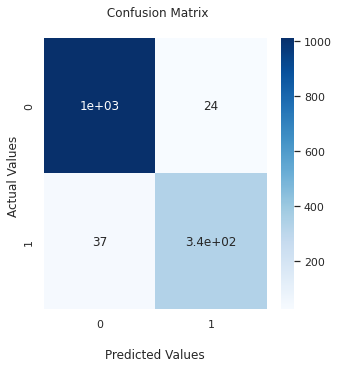

In [ ]:
# Displaying Confusion Matrix
cf_matrix = confusion_matrix(y_test,y_pred)
sns.set(rc={'figure.figsize':(5,5)})
ax = sns.heatmap(cf_matrix, annot=True, cmap='Blues')

ax.set_title(' Confusion Matrix\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['0','1'])
ax.yaxis.set_ticklabels(['0','1'])

In [ ]:
#Model Evaluation
accuracy  = metrics.accuracy_score(y_test,y_pred)
recall = metrics.recall_score(y_test,y_pred)
precision = metrics.precision_score(y_test,y_pred)
f1_score = metrics.f1_score(y_test,y_pred)

print(f'Model Accuracy = {100*accuracy:0.3} %' )
print(f'Model recall = {100*recall:0.3} %' )
print(f'Model precision = {100*precision:0.3} %' )
print(f'Model f1_score = {100*f1_score:0.3} %' )

Model Accuracy = 95.7 %
Model recall = 90.1 %
Model precision = 93.3 %
Model f1_score = 91.7 %


Text(0, 0.5, 'True Positive Rate (Sensitivity)')

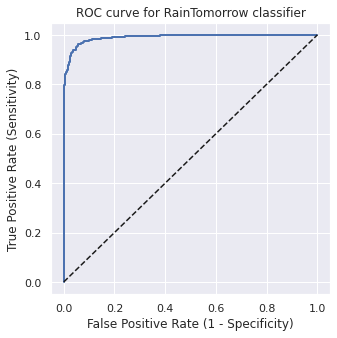

In [ ]:
#ROC Curve
y_pred_proba = Logmodel.predict_proba(x_test)[::,1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

plt.plot(fpr, tpr, linewidth=2)
plt.plot([0,1], [0,1], 'k--' )
plt.title('ROC curve for RainTomorrow classifier')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')

In [ ]:
# ROC Evaluation
ROC_AUC = metrics.roc_auc_score(y_test,y_pred_proba)
print(f'Model ROC_AUC = {100*ROC_AUC:0.3} %' )

Model ROC_AUC = 99.0 %


## XGboost

In [ ]:
# XGBoost Fitting
XGB_model = XGBClassifier()
XGB_model.fit(x_train,y_train)
y_pred = XGB_model.predict(x_test)

class_report = metrics.classification_report(y_test,y_pred)
print(class_report)

              precision    recall  f1-score   support

           0       0.96      0.99      0.97      1036
           1       0.96      0.89      0.92       373

    accuracy                           0.96      1409
   macro avg       0.96      0.94      0.95      1409
weighted avg       0.96      0.96      0.96      1409



[Text(0, 0.5, '0'), Text(0, 1.5, '1')]

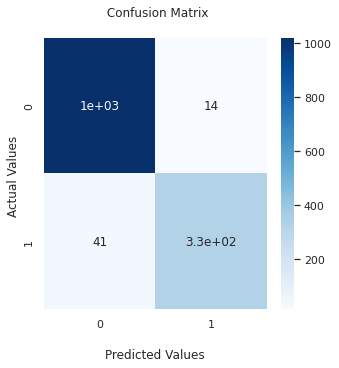

In [ ]:
# Displaying Confusion Matrix
cf_matrix = confusion_matrix(y_test,y_pred)
sns.set(rc={'figure.figsize':(5,5)})
ax = sns.heatmap(cf_matrix, annot=True, cmap='Blues')

ax.set_title(' Confusion Matrix\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['0','1'])
ax.yaxis.set_ticklabels(['0','1'])

In [ ]:
#Model Evaluation
accuracy  = metrics.accuracy_score(y_test,y_pred)
recall = metrics.recall_score(y_test,y_pred)
precision = metrics.precision_score(y_test,y_pred)
f1_score = metrics.f1_score(y_test,y_pred)

print(f'Model Accuracy = {100*accuracy:0.3} %' )
print(f'Model recall = {100*recall:0.3} %' )
print(f'Model precision = {100*precision:0.3} %' )
print(f'Model f1_score = {100*f1_score:0.3} %' )

Model Accuracy = 96.1 %
Model recall = 89.0 %
Model precision = 96.0 %
Model f1_score = 92.4 %


Text(0, 0.5, 'True Positive Rate (Sensitivity)')

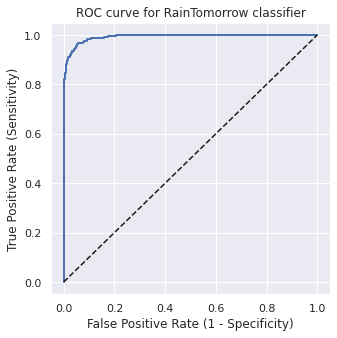

In [ ]:
#ROC Curve
y_pred_proba = XGB_model.predict_proba(x_test)[::,1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

plt.plot(fpr, tpr, linewidth=2)
plt.plot([0,1], [0,1], 'k--' )
plt.title('ROC curve for RainTomorrow classifier')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')

In [ ]:
# ROC Evaluation
ROC_AUC = metrics.roc_auc_score(y_test,y_pred_proba)
print(f'Model ROC_AUC = {100*ROC_AUC:0.3} %' )

Model ROC_AUC = 99.3 %


## Conclusion


*Using Lazy Classifier, the best results were obtained using Logitic Regression & XGBoost.

*Logitic Regression Score:

Model Accuracy = 95.7 %

Model recall = 90.1 %

Model precision = 93.3 %

Model f1_score = 91.7 %

*XGBoost Score:

Model Accuracy = 96.1 %

Model recall = 89.0 %

Model precision = 96.0 %

Model f1_score = 92.4 %

----------------------------------------------------------------------------------------------------------------------------------------------------------------

# D) Deep Learning

## Keras

In [64]:
# Building Model
model = Sequential([
    BatchNormalization(input_shape=(len(list(x.columns)),)),
    Dense(12,activation='relu'),

    Dropout(0.2),
    Dense(6,activation='relu'),

    Dense(1,activation='sigmoid')
])

early_stop = EarlyStopping(monitor='val_loss',patience=5)

# Model Summary
model._name="Customer_Churn_Model"
model.summary()

Model: "Customer_Churn_Model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 batch_normalization_3 (Batc  (None, 33)               132       
 hNormalization)                                                 
                                                                 
 dense_9 (Dense)             (None, 12)                408       
                                                                 
 dropout_3 (Dropout)         (None, 12)                0         
                                                                 
 dense_10 (Dense)            (None, 6)                 78        
                                                                 
 dense_11 (Dense)            (None, 1)                 7         
                                                                 
Total params: 625
Trainable params: 559
Non-trainable params: 66
_______________________________________________

In [65]:
# Opitmizer
opt = keras.optimizers.Adam(
    learning_rate=0.001,
    beta_1=0.9,
    beta_2=0.999,
    epsilon=1e-07,
    amsgrad=False,
    name="Adam",
    )

# Compiling and fitting model
model.compile(optimizer=opt,loss='binary_crossentropy',metrics=['accuracy'])
model.fit(x,y,epochs=100, validation_split=0.1, callbacks=[early_stop])

Epoch 1/100
199/199 [==============================] - 2s 5ms/step - loss: 0.5172 - accuracy: 0.7537 - val_loss: 0.4220 - val_accuracy: 0.7660
Epoch 2/100
199/199 [==============================] - 1s 4ms/step - loss: 0.3007 - accuracy: 0.8818 - val_loss: 0.1748 - val_accuracy: 0.9376
Epoch 3/100
199/199 [==============================] - 1s 4ms/step - loss: 0.1979 - accuracy: 0.9221 - val_loss: 0.1300 - val_accuracy: 0.9447
Epoch 4/100
199/199 [==============================] - 1s 4ms/step - loss: 0.1721 - accuracy: 0.9303 - val_loss: 0.1151 - val_accuracy: 0.9504
Epoch 5/100
199/199 [==============================] - 1s 4ms/step - loss: 0.1589 - accuracy: 0.9339 - val_loss: 0.1101 - val_accuracy: 0.9504
Epoch 6/100
199/199 [==============================] - 1s 4ms/step - loss: 0.1565 - accuracy: 0.9340 - val_loss: 0.1067 - val_accuracy: 0.9475
Epoch 7/100
199/199 [==============================] - 1s 4ms/step - loss: 0.1465 - accuracy: 0.9388 - val_loss: 0.1053 - val_accuracy: 0.9589

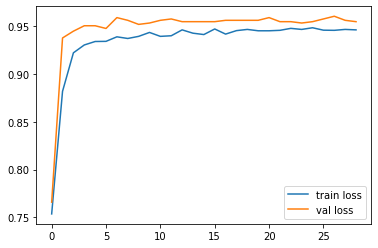

In [66]:
# plot the loss
plt.plot(model.history.history['accuracy'],label='train loss')
plt.plot(model.history.history['val_accuracy'],label='val loss')
plt.legend()

## Keras Tuner


In [67]:
# Create model to start tuning
def model_builder(hp):
  model = keras.Sequential()
  model.add(BatchNormalization(input_shape=(len(list(x.columns)),)))

  hp_units = hp.Int('units', min_value=32, max_value=512, step=32)
  model.add(keras.layers.Dense(units=hp_units,activation='relu'))
  model.add(keras.layers.Dropout(0.2))
  model.add(keras.layers.Dense(48,activation="relu"))
  model.add(keras.layers.Dense(1,activation="sigmoid"))

  hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])

  opt = keras.optimizers.Adam(
    learning_rate=hp_learning_rate,
    beta_1=0.9,
    beta_2=0.999,
    epsilon=1e-07,
    amsgrad=False,
    name="Adam",
    )

  model.compile(optimizer=opt,loss="binary_crossentropy",metrics=['accuracy'])

  return model

In [68]:
# Configuring Tuner
tuner = kt.Hyperband(model_builder,
                     objective='val_accuracy',
                     max_epochs=100,
                     factor=3,
                     directory='Keras Tuning',
                     project_name='Customer Churn')

# Early Stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=5)

In [69]:
# Search for optimal hyperparameters
tuner.search(x_train, y_train, epochs=100, validation_split=0.2, callbacks=[early_stopping])

# Get the optimal hyperparameters
best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"""
The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is {best_hps.get('units')} and the optimal learning rate for the optimizer
is {best_hps.get('learning_rate')}.
""")


The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is 128 and the optimal learning rate for the optimizer
is 0.01.



In [72]:
# Build the model with the optimal hyperparameters and train it on the data for 50 epochs
model = tuner.hypermodel.build(best_hps)
history = model.fit(x_train, y_train, epochs=100, validation_split=0.2)

val_acc_per_epoch = history.history['accuracy']
best_epoch = val_acc_per_epoch.index(max(val_acc_per_epoch)) + 1
print('Best epoch: %d' % (best_epoch,))

Epoch 1/100
141/141 [==============================] - 3s 9ms/step - loss: 0.1942 - accuracy: 0.9128 - val_loss: 0.3452 - val_accuracy: 0.8988
Epoch 2/100
141/141 [==============================] - 1s 4ms/step - loss: 0.1369 - accuracy: 0.9408 - val_loss: 0.1216 - val_accuracy: 0.9459
Epoch 3/100
141/141 [==============================] - 1s 5ms/step - loss: 0.1218 - accuracy: 0.9463 - val_loss: 0.1058 - val_accuracy: 0.9485
Epoch 4/100
141/141 [==============================] - 1s 4ms/step - loss: 0.1323 - accuracy: 0.9416 - val_loss: 0.1046 - val_accuracy: 0.9521
Epoch 5/100
141/141 [==============================] - 1s 4ms/step - loss: 0.1301 - accuracy: 0.9445 - val_loss: 0.1141 - val_accuracy: 0.9512
Epoch 6/100
141/141 [==============================] - 1s 4ms/step - loss: 0.1190 - accuracy: 0.9481 - val_loss: 0.1197 - val_accuracy: 0.9476
Epoch 7/100
141/141 [==============================] - 1s 4ms/step - loss: 0.1388 - accuracy: 0.9452 - val_loss: 0.1250 - val_accuracy: 0.9441

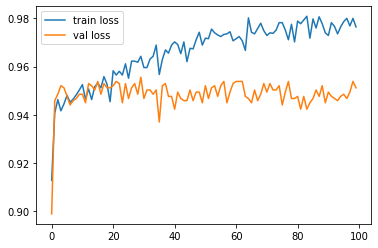

In [76]:
# plot the loss
plt.plot(model.history.history['accuracy'],label='train loss')
plt.plot(model.history.history['val_accuracy'],label='val loss')
plt.legend()

In [73]:
hypermodel = tuner.hypermodel.build(best_hps)

# Retrain the model
hypermodel.fit(x_train, y_train, epochs=best_epoch, validation_split=0.2)

Epoch 1/84
141/141 [==============================] - 1s 5ms/step - loss: 0.1958 - accuracy: 0.9164 - val_loss: 1.3660 - val_accuracy: 0.7329
Epoch 2/84
141/141 [==============================] - 1s 4ms/step - loss: 0.1430 - accuracy: 0.9350 - val_loss: 0.1420 - val_accuracy: 0.9299
Epoch 3/84
141/141 [==============================] - 0s 3ms/step - loss: 0.1383 - accuracy: 0.9423 - val_loss: 0.1077 - val_accuracy: 0.9539
Epoch 4/84
141/141 [==============================] - 0s 3ms/step - loss: 0.1363 - accuracy: 0.9419 - val_loss: 0.1157 - val_accuracy: 0.9450
Epoch 5/84
141/141 [==============================] - 0s 3ms/step - loss: 0.1293 - accuracy: 0.9465 - val_loss: 0.1166 - val_accuracy: 0.9512
Epoch 6/84
141/141 [==============================] - 1s 4ms/step - loss: 0.1223 - accuracy: 0.9472 - val_loss: 0.1066 - val_accuracy: 0.9494
Epoch 7/84
141/141 [==============================] - 1s 4ms/step - loss: 0.1284 - accuracy: 0.9428 - val_loss: 0.1148 - val_accuracy: 0.9468
Epoch 

In [74]:
eval_result = hypermodel.evaluate(x_test, y_test)
print("[test loss, test accuracy]:", eval_result)

45/45 [==============================] - 0s 2ms/step - loss: 0.2121 - accuracy: 0.9517
[test loss, test accuracy]: [0.21213684976100922, 0.9517388343811035]


## Conclusion

*Using keras , the best accuracy obtained was 0.9460

*After Tuning some hyper parameters using keras tuner, the best accuracy obtained was 0.9765 at epoch 85. 

Also, loss: 0.0601  - val_loss: 0.1859 - val_accuracy: 0.9512

----------------------------------------------------------------------------------------------------------------------------------------------------------------